<a href="https://colab.research.google.com/github/kelvinrobot/AI_FRAUD_DETECTION/blob/main/AI_FLOOD_DETECTION_STAGE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install catboost
!pip install xgboost lightgbm
!pip install shap
!pip install scikit-learn
!pip install pandas numpy matplotlib seaborn
!pip install tensorflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 9.4 MB/s eta 0:00:00


In [2]:
!pip install torch


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 102.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 108.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitl

In [17]:
!pip install imbalanced-learn


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, mean_squared_error
from sklearn.preprocessing import MinMaxScaler, LabelEncoder




In [4]:
from google.colab import files
files.upload()

Saving cleaned_data_with_fuzzy.csv to cleaned_data_with_fuzzy.csv


{'cleaned_data_with_fuzzy.csv': b'Average temp,humidity,precip,windspeed,sealevelpressure,cloudcover,solarradiation,severerisk,flood,moonphase_0.0,moonphase_0.02,moonphase_0.03,moonphase_0.04,moonphase_0.05,moonphase_0.06,moonphase_0.07,moonphase_0.08,moonphase_0.09,moonphase_0.1,moonphase_0.11,moonphase_0.12,moonphase_0.13,moonphase_0.14,moonphase_0.15,moonphase_0.16,moonphase_0.17,moonphase_0.18,moonphase_0.19,moonphase_0.2,moonphase_0.21,moonphase_0.22,moonphase_0.23,moonphase_0.24,moonphase_0.25,moonphase_0.26,moonphase_0.27,moonphase_0.28,moonphase_0.29,moonphase_0.3,moonphase_0.31,moonphase_0.32,moonphase_0.33,moonphase_0.34,moonphase_0.35,moonphase_0.36,moonphase_0.37,moonphase_0.38,moonphase_0.39,moonphase_0.4,moonphase_0.41,moonphase_0.42,moonphase_0.43,moonphase_0.44,moonphase_0.45,moonphase_0.46,moonphase_0.47,moonphase_0.48,moonphase_0.5,moonphase_0.52,moonphase_0.53,moonphase_0.54,moonphase_0.55,moonphase_0.56,moonphase_0.57,moonphase_0.58,moonphase_0.59,moonphase_0.6,moon

In [43]:
df = pd.read_csv('cleaned_data_with_fuzzy.csv')

df.head(10)

,Average temp,humidity,precip,windspeed,sealevelpressure,cloudcover,solarradiation,severerisk,flood,moonphase_0.0,...,month_10,month_11,month_12,flood_lag_1,flood_lag_2,flood_lag_3,flood_lag_4,flood_lag_5,SMI_linear_norm,flood_risk_score
0,28.8,79.6,0.0,13.0,1010.5,33.3,232.8,0,0,False,...,False,False,False,0,0,0,0,0,0.379214,0.1
1,28.5,83.9,0.1,13.0,1012.0,37.8,209.1,0,0,False,...,False,False,False,0,0,0,0,0,0.409373,0.2
2,29.0,79.6,0.0,13.0,1011.8,34.1,207.5,0,0,False,...,False,False,False,0,0,0,0,0,0.369670,0.1
3,29.0,73.1,0.0,12.8,1010.4,37.0,220.8,0,0,False,...,False,False,False,0,0,0,0,0,0.345755,0.1
4,28.4,76.6,0.0,16.6,1009.6,36.6,241.3,0,0,False,...,False,False,False,0,0,0,0,0,0.390310,0.1
5,28.0,81.4,0.0,22.3,1009.8,32.9,227.4,0,0,False,...,False,False,False,0,0,0,0,0,0.431638,0.2
6,28.8,79.8,0.0,18.4,1011.3,45.2,224.2,0,0,False,...,False,False,False,0,0,0,0,0,0.384398,0.1
7,28.8,82.7,0.2,11.2,1011.2,46.5,198.9,0,0,False,...,False,False,False,0,0,0,0,0,0.389320,0.6
8,28.2,57.6,0.0,16.6,1009.6,31.0,241.0,0,0,False,...,False,False,False,0,0,0,0,0,0.330433,0.1
9,26.4,68.3,0.0,11.2,1009.6,27.1,229.4,0,0,False,...,False,False,False,0,0,0,0,0,0.450973,0.1


In [48]:
print(df.columns.tolist())


['Average temp', 'humidity', 'precip', 'windspeed', 'sealevelpressure', 'cloudcover', 'solarradiation', 'severerisk', 'flood', 'moonphase_0.0', 'moonphase_0.02', 'moonphase_0.03', 'moonphase_0.04', 'moonphase_0.05', 'moonphase_0.06', 'moonphase_0.07', 'moonphase_0.08', 'moonphase_0.09', 'moonphase_0.1', 'moonphase_0.11', 'moonphase_0.12', 'moonphase_0.13', 'moonphase_0.14', 'moonphase_0.15', 'moonphase_0.16', 'moonphase_0.17', 'moonphase_0.18', 'moonphase_0.19', 'moonphase_0.2', 'moonphase_0.21', 'moonphase_0.22', 'moonphase_0.23', 'moonphase_0.24', 'moonphase_0.25', 'moonphase_0.26', 'moonphase_0.27', 'moonphase_0.28', 'moonphase_0.29', 'moonphase_0.3', 'moonphase_0.31', 'moonphase_0.32', 'moonphase_0.33', 'moonphase_0.34', 'moonphase_0.35', 'moonphase_0.36', 'moonphase_0.37', 'moonphase_0.38', 'moonphase_0.39', 'moonphase_0.4', 'moonphase_0.41', 'moonphase_0.42', 'moonphase_0.43', 'moonphase_0.44', 'moonphase_0.45', 'moonphase_0.46', 'moonphase_0.47', 'moonphase_0.48', 'moonphase_0.5

dropping moon phase

In [49]:
moonphase_cols = [col for col in df.columns if col.startswith('moonphase_')]

df = df.drop(columns=moonphase_cols)
print('dropped moonphase columns:', len(moonphase_cols))

dropped moonphase columns: 96


making long months list to be one feature month

In [68]:
month_cols = [col for col in df.columns if col.startswith('month_')]

def extract_month(row):
  for i, col in enumerate(month_cols):
    if row[col] == True or row[col] == 1:
      return i + 1
      return 0

df['month'] = df.apply(extract_month, axis = 1)
df = df.drop(columns = month_cols)
print('converted one-hot months to month column')

converted one-hot months to month column


In [51]:
# We drop 'flood' and 'flood_risk_score' from inputs  but keep as labels
label_cols = ['flood', 'flood_risk_score']
all_input_cols = df.columns.tolist()
input_cols = [col for col in all_input_cols if col not in label_cols]

print(" Final input features before scaling:\n", input_cols)


 Final input features before scaling:
 ['Average temp', 'humidity', 'precip', 'windspeed', 'sealevelpressure', 'cloudcover', 'solarradiation', 'severerisk', 'flood_lag_1', 'flood_lag_2', 'flood_lag_3', 'flood_lag_4', 'flood_lag_5', 'SMI_linear_norm', 'month']


In [56]:
df.head(5)

,Average temp,humidity,precip,windspeed,sealevelpressure,cloudcover,solarradiation,severerisk,flood,flood_lag_1,flood_lag_2,flood_lag_3,flood_lag_4,flood_lag_5,SMI_linear_norm,flood_risk_score,month
0,28.8,79.6,0.0,13.0,1010.5,33.3,232.8,0,0,0,0,0,0,0,0.379214,0.1,None
1,28.5,83.9,0.1,13.0,1012.0,37.8,209.1,0,0,0,0,0,0,0,0.409373,0.2,None
2,29.0,79.6,0.0,13.0,1011.8,34.1,207.5,0,0,0,0,0,0,0,0.369670,0.1,None
3,29.0,73.1,0.0,12.8,1010.4,37.0,220.8,0,0,0,0,0,0,0,0.345755,0.1,None
4,28.4,76.6,0.0,16.6,1009.6,36.6,241.3,0,0,0,0,0,0,0,0.390310,0.1,None


normalize input features using minmax scaling

In [10]:
scaler = MinMaxScaler()
df[input_cols] = scaler.fit_transform(df[input_cols])
print('normalized input features')

normalized input features


final dataset shape: (41201, 17)
input sample:
    flood  flood_risk_score
0      0               0.1
1      0               0.2
2      0               0.1
3      0               0.1
4      0               0.1


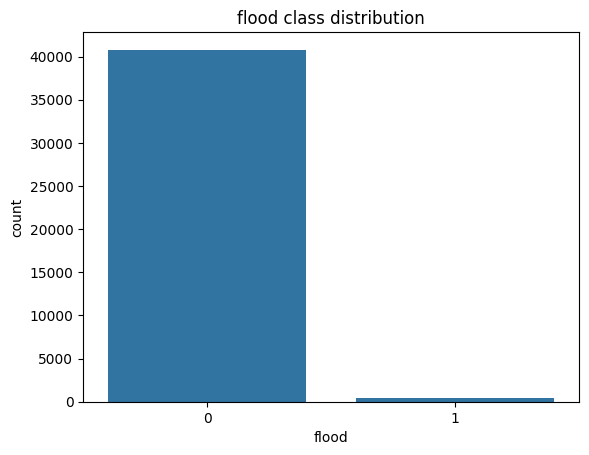

In [11]:
print('final dataset shape:', df.shape)
print('input sample:\n', df[['flood', 'flood_risk_score']].head())

sns.countplot(data=df, x='flood')
plt.title('flood class distribution')
plt.show()

balancing dataset

In [12]:
# Split into positive and negative classes
df_flood = df[df['flood'] == 1]
df_noflood = df[df['flood'] == 0]

print("Flood:", len(df_flood), "No Flood:", len(df_noflood))


Flood: 410 No Flood: 40791


In [13]:
# Downsample 0s to match number of 1s
df_noflood_downsampled = df_noflood.sample(n=len(df_flood), random_state=42)


 Balanced data shape: (820, 17)


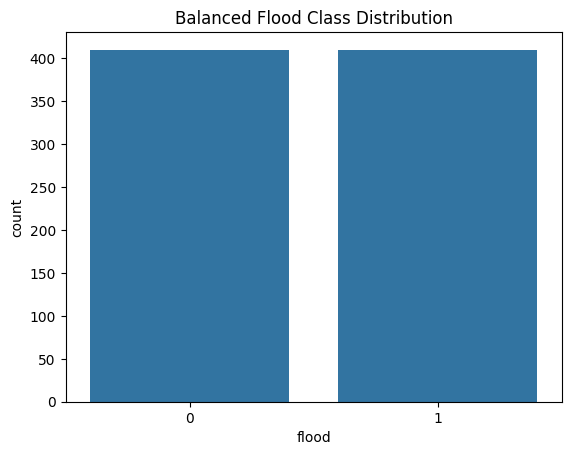

In [14]:
df_balanced = pd.concat([df_flood, df_noflood_downsampled]).sample(frac=1, random_state=42).reset_index(drop=True)
print(" Balanced data shape:", df_balanced.shape)


import seaborn as sns
import matplotlib.pyplot as plt

sns.countplot(data=df_balanced, x='flood')
plt.title("Balanced Flood Class Distribution")
plt.show()


In [15]:
X = df_balanced[input_cols].copy()
y_class = df_balanced['flood']                # for classification
y_risk  = df_balanced['flood_risk_score']     # for regression


spliting balanced data for catboost

In [16]:
X_cat = df_balanced[input_cols].copy()
y_cat = df_balanced['flood'].copy()

X_train, X_test, y_train, y_test = train_test_split(X_cat, y_cat, test_size=0.2, random_state=42, stratify=y_cat)

print(" Train size:", X_train.shape)
print(" Test size:", X_test.shape)


 Train size: (656, 15)
 Test size: (164, 15)


using SMOTE which is synthetic minority over sampling techniques

In [19]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np

X_full = df[input_cols].copy()  # only real input features
y_full = df['flood'].copy()     # classification label

print("Before SMOTE:\n", y_full.value_counts())

Before SMOTE:
 flood
0    40791
1      410
Name: count, dtype: int64


In [20]:
smote = SMOTE(random_state=42)
X_smote, y_smote = smote.fit_resample(X_full, y_full)

print(" After SMOTE:\n", pd.Series(y_smote).value_counts())


 After SMOTE:
 flood
0    40791
1    40791
Name: count, dtype: int64


In [21]:
X_train, X_test, y_train, y_test = train_test_split(
    X_smote, y_smote,
    test_size=0.2,
    stratify=y_smote,
    random_state=42
)

print(" SMOTE Train size:", X_train.shape)
print(" Balanced class distribution in train:", pd.Series(y_train).value_counts())


 SMOTE Train size: (65265, 15)
 Balanced class distribution in train: flood
1    32633
0    32632
Name: count, dtype: int64


training the catboost classifier

In [22]:
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

model_catboost = CatBoostClassifier(
    iterations=1000,          # number of trees
    learning_rate=0.03,       # step size
    depth=6,                  # depth of each tree
    loss_function='Logloss',  # binary classification
    eval_metric='Accuracy',   # what to monitor
    verbose=100,              # print every 100 iterations
    random_seed=42
)

# Train the model
model_catboost.fit(X_train, y_train, eval_set=(X_test, y_test), use_best_model=True)


0:	learn: 0.7758829	test: 0.7713428	best: 0.7713428 (0)	total: 84.4ms	remaining: 1m 24s
100:	learn: 0.9628591	test: 0.9629834	best: 0.9629834 (100)	total: 1.54s	remaining: 13.7s
200:	learn: 0.9881713	test: 0.9883557	best: 0.9883557 (200)	total: 2.95s	remaining: 11.7s
300:	learn: 0.9946372	test: 0.9933811	best: 0.9934424 (297)	total: 4.39s	remaining: 10.2s
400:	learn: 0.9977630	test: 0.9967519	best: 0.9968131 (394)	total: 7.17s	remaining: 10.7s
500:	learn: 0.9990653	test: 0.9983453	best: 0.9983453 (493)	total: 8.6s	remaining: 8.57s
600:	learn: 0.9994484	test: 0.9990194	best: 0.9992646 (598)	total: 10s	remaining: 6.66s
700:	learn: 0.9998008	test: 0.9995710	best: 0.9995710 (699)	total: 11.4s	remaining: 4.87s
800:	learn: 0.9999540	test: 0.9998161	best: 0.9998161 (779)	total: 12.8s	remaining: 3.19s
900:	learn: 0.9999694	test: 0.9998774	best: 0.9998774 (808)	total: 14.3s	remaining: 1.57s
999:	learn: 1.0000000	test: 0.9998774	best: 0.9998774 (808)	total: 15.6s	remaining: 0us

bestTest = 0.999

evaluating catboost model

In [23]:
# Make predictions
y_pred = model_catboost.predict(X_test)

# Print evaluation metrics
print(" Accuracy:", accuracy_score(y_test, y_pred))
print("\n Classification Report:\n", classification_report(y_test, y_pred))
print("\n Confusion Matrix:\n", confusion_matrix(y_test, y_pred))


 Accuracy: 0.9998774284488571

 Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      8159
           1       1.00      1.00      1.00      8158

    accuracy                           1.00     16317
   macro avg       1.00      1.00      1.00     16317
weighted avg       1.00      1.00      1.00     16317


 Confusion Matrix:
 [[8157    2]
 [   0 8158]]


In [24]:
model_catboost.save_model("catboost_flood_model.cbm")
print(" Model saved as 'catboost_flood_model.cbm'")


 Model saved as 'catboost_flood_model.cbm'


re cleaning flood_risk_score target for xgboost model

In [64]:
# Remove rows where the target is missing or invalid
mask = df['flood_risk_score'].notna() & np.isfinite(df['flood_risk_score']) & (df['flood_risk_score'] <=1.0)
df_clean = df[mask].copy()

X_risk = df_clean[input_cols].copy()
y_risk = df_clean['flood_risk_score'].copy()

X_train_risk, X_test_risk, y_train_risk, y_test_risk = train_test_split(
    X_risk, y_risk, test_size=0.2, random_state=42
)

print(" Remaining rows:", len(df_clean))
print(" Any NaNs?", df_clean['flood_risk_score'].isna().sum())
print(" Any infs?", np.isinf(df_clean['flood_risk_score']).sum())
print(" Max score:", df_clean['flood_risk_score'].max())
print(" Min score:", df_clean['flood_risk_score'].min())



 Remaining rows: 40423
 Any NaNs? 0
 Any infs? 0
 Max score: 0.8666666666666667
 Min score: 0.0999999999999999


building xgboost model

In [66]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split


X_risk = df_clean[input_cols].copy()

# Target flood_risk_score continuous from 0.0 to 1.0
y_risk = df_clean['flood_risk_score'].copy()


X_train_risk, X_test_risk, y_train_risk, y_test_risk = train_test_split(
    X_risk, y_risk, test_size=0.2, random_state=42
)

xgb_model = xgb.XGBRegressor(
    n_estimators=500,
    learning_rate=0.05,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42
)

xgb_model.fit(X_train_risk, y_train_risk)


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.05, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=500, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [67]:
y_pred_risk = xgb_model.predict(X_test_risk)

mse = mean_squared_error(y_test_risk, y_pred_risk)
r2 = r2_score(y_test_risk, y_pred_risk)

print(f"MSE: {mse:.6f}")
print(f" R² Score: {r2:.4f}")


MSE: 0.000003
 R² Score: 1.0000


In [41]:
import joblib
joblib.dump(xgb_model, "xgboost_flood_risk_model.pkl")



['xgboost_flood_risk_model.pkl']

In [69]:
df_clean = df.copy()

month_flags = [col for col in df_clean.columns if col.startswith("month_")]
lag_features = [col for col in df_clean.columns if col.startswith("flood_lag_")]


df_clean[month_flags] = df_clean[month_flags].astype(int)


if 'month' not in df_clean.columns or df_clean['month'].isnull().all():
    df_clean['month'] = np.tile(np.arange(1, 13), len(df_clean) // 12 + 1)[:len(df_clean)]


In [73]:
df_clean.head(2)

,Average temp,humidity,precip,windspeed,sealevelpressure,cloudcover,solarradiation,severerisk,flood,flood_lag_1,flood_lag_2,flood_lag_3,flood_lag_4,flood_lag_5,SMI_linear_norm,flood_risk_score,month
0,28.8,79.6,0.0,13.0,1010.5,33.3,232.8,0,0,0,0,0,0,0,0.379214,0.1,1
1,28.5,83.9,0.1,13.0,1012.0,37.8,209.1,0,0,0,0,0,0,0,0.409373,0.2,2


adding severity level

In [74]:

if 'flood_risk_score' not in df_clean.columns:
    raise ValueError(" 'flood_risk_score' column not found in df_clean!")


def classify_severity(score):
    if score < 0.3:
        return 0  # Low
    elif score < 0.7:
        return 1  # Mid
    else:
        return 2  # High

df_clean['flood_severity_class'] = df_clean['flood_risk_score'].apply(classify_severity)


print(df_clean['flood_severity_class'].value_counts())


flood_severity_class
0    23661
2    10322
1     6440
Name: count, dtype: int64


In [76]:
X = df_clean[input_cols].copy()
y = df_clean['flood_severity_class'].astype(int)  # New: 0 = low, 1 = mid, 2 = high

import numpy as np

sequence_length = 7

X_seq = []
y_seq = []

for i in range(len(X) - sequence_length):
    X_seq.append(X.iloc[i:i+sequence_length].values)
    y_seq.append(y.iloc[i+sequence_length])  # label is after the sequence

X_seq = np.array(X_seq)
y_seq = np.array(y_seq)


loading dataset for lstm

In [77]:
import torch
from torch.utils.data import Dataset, DataLoader

class SeverityDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

dataset = SeverityDataset(X_seq, y_seq)

train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size

train_ds, test_ds = torch.utils.data.random_split(dataset, [train_size, test_size])
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=32)


build the lstm model

In [78]:
import torch.nn as nn

class LSTMSeverityClassifier(nn.Module):
    def __init__(self, input_dim, hidden_dim=64, output_dim=3, num_layers=2):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out[:, -1])  # use last time step
        return out


train the model

In [79]:
model = LSTMSeverityClassifier(input_dim=X_seq.shape[2])
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Training loop
for epoch in range(20):
    model.train()
    total_loss = 0

    for xb, yb in train_loader:
        optimizer.zero_grad()
        out = model(xb)
        loss = criterion(out, yb)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    print(f"Epoch {epoch+1} loss: {total_loss:.4f}")


Epoch 1 loss: 908.3842
Epoch 2 loss: 881.6871
Epoch 3 loss: 868.7101
Epoch 4 loss: 857.3033
Epoch 5 loss: 847.7020
Epoch 6 loss: 842.9359
Epoch 7 loss: 832.3110
Epoch 8 loss: 827.6738
Epoch 9 loss: 825.6917
Epoch 10 loss: 817.6107
Epoch 11 loss: 812.5330
Epoch 12 loss: 806.5917
Epoch 13 loss: 804.8378
Epoch 14 loss: 794.4438
Epoch 15 loss: 786.5105
Epoch 16 loss: 770.9588
Epoch 17 loss: 755.1098
Epoch 18 loss: 741.7583
Epoch 19 loss: 721.1873
Epoch 20 loss: 699.7223


evaluation

In [80]:
from sklearn.metrics import classification_report

model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for xb, yb in test_loader:
        preds = model(xb).argmax(dim=1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(yb.cpu().numpy())

print(classification_report(all_labels, all_preds, target_names=["Low", "Mid", "High"]))


              precision    recall  f1-score   support

         Low       0.80      0.76      0.78      4756
         Mid       0.44      0.28      0.34      1231
        High       0.52      0.70      0.59      2097

    accuracy                           0.67      8084
   macro avg       0.59      0.58      0.57      8084
weighted avg       0.67      0.67      0.66      8084



In [82]:
torch.save(model.state_dict(), "lstm_flood_model_weights.pth")

In [83]:

X_auto = df_clean[df_clean['flood'] == 0][input_cols].copy()

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_auto_scaled = scaler.fit_transform(X_auto)

# Save scaler for later use
import joblib
joblib.dump(scaler, "autoencoder_scaler.pkl")


['autoencoder_scaler.pkl']

defining autoencoder archetechture

In [84]:
import torch
import torch.nn as nn

class FloodAutoencoder(nn.Module):
    def __init__(self, input_dim):
        super(FloodAutoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(64, input_dim)
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded


prepare training dataLoader

In [85]:
from torch.utils.data import TensorDataset, DataLoader

X_tensor = torch.tensor(X_auto_scaled, dtype=torch.float32)
dataset = TensorDataset(X_tensor)
loader = DataLoader(dataset, batch_size=64, shuffle=True)


training the autoencoder

In [86]:
model = FloodAutoencoder(input_dim=X_tensor.shape[1])
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

num_epochs = 50
for epoch in range(num_epochs):
    total_loss = 0
    for batch in loader:
        x = batch[0]
        optimizer.zero_grad()
        output = model(x)
        loss = criterion(output, x)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss:.6f}")


Epoch 1/50, Loss: 96.049887
Epoch 2/50, Loss: 4.504384
Epoch 3/50, Loss: 2.846080
Epoch 4/50, Loss: 1.968489
Epoch 5/50, Loss: 1.550170
Epoch 6/50, Loss: 1.242537
Epoch 7/50, Loss: 1.049380
Epoch 8/50, Loss: 0.894498
Epoch 9/50, Loss: 0.684129
Epoch 10/50, Loss: 0.764259
Epoch 11/50, Loss: 0.613036
Epoch 12/50, Loss: 0.540767
Epoch 13/50, Loss: 0.494663
Epoch 14/50, Loss: 0.527708
Epoch 15/50, Loss: 0.425620
Epoch 16/50, Loss: 0.457213
Epoch 17/50, Loss: 0.522399
Epoch 18/50, Loss: 0.415910
Epoch 19/50, Loss: 0.349414
Epoch 20/50, Loss: 0.436270
Epoch 21/50, Loss: 0.268085
Epoch 22/50, Loss: 0.388428
Epoch 23/50, Loss: 0.397758
Epoch 24/50, Loss: 0.308077
Epoch 25/50, Loss: 0.291438
Epoch 26/50, Loss: 0.351653
Epoch 27/50, Loss: 0.259598
Epoch 28/50, Loss: 0.291043
Epoch 29/50, Loss: 0.300961
Epoch 30/50, Loss: 0.286495
Epoch 31/50, Loss: 0.293781
Epoch 32/50, Loss: 0.224850
Epoch 33/50, Loss: 0.387957
Epoch 34/50, Loss: 0.185739
Epoch 35/50, Loss: 0.229727
Epoch 36/50, Loss: 0.213032


using autoencoder to predict flood risk

In [88]:

X_all = df_clean[input_cols]
X_all_scaled = scaler.transform(X_all)
X_all_tensor = torch.tensor(X_all_scaled, dtype=torch.float32)

# Reconstruct
with torch.no_grad():
    X_reconstructed = model(X_all_tensor).numpy()

# Calculate reconstruction error
import numpy as np
reconstruction_error = np.mean((X_all_scaled - X_reconstructed)**2, axis=1)

# Save error to DataFrame
df_clean['autoencoder_error'] = reconstruction_error


In [89]:
torch.save(model.state_dict(), "flood_autoencoder_weights.pth")


combining all models

In [90]:
!zip -r flood_ai_models.zip \
    catboost_flood_model.cbm \
    xgboost_flood_model.pkl \
    lstm_flood_model_weights.pth \
    flood_autoencoder_weights.pth \
    autoencoder_scaler.pkl \
    xgb_scaler.pkl


	zip warning: name not matched: xgboost_flood_model.pkl
	zip warning: name not matched: xgb_scaler.pkl
  adding: catboost_flood_model.cbm (deflated 62%)
  adding: lstm_flood_model_weights.pth (deflated 9%)
  adding: flood_autoencoder_weights.pth (deflated 15%)
  adding: autoencoder_scaler.pkl (deflated 28%)
